# Analyzing SASUMO outputs


### Import the Required Libraries


In [1]:
import os
import sys
import pathlib
from copy import deepcopy


In [2]:
def find_root(path):
    if os.path.split(path)[-1] != "airport-harper-sumo":
        return find_root(os.path.split(path)[0])
    return path


In [3]:
import pathlib

PATH = find_root(pathlib.Path().absolute())
if PATH not in sys.path:
    print(f"adding {PATH} to path")
    sys.path.append(PATH)


adding /Users/max/Development/airport-harper-sumo to path


In [4]:
import json5 as json
import sys

import numpy as np
import pandas as pd
import plotly.graph_objects as go
import plotly.express as px
from plotly.subplots import make_subplots

from SALib.analyze import sobol
from SALib.analyze import pawn, delta

from SASUMO.params import SASUMOConf

# from SASUMO.params import SASUMOConf, ReplayProcessConf


In [5]:
NAME_2_LATEX = {
    "RandomSeed": r"$\large{\text{seed}}$",
    "Tau": r"$\large{\tau}$",
    "TauDev": r"$\large{\tau^{\sigma}}$",
    "TauDist": r"$\large{\tau^{\text{dist}}}$",
    "Accel": r"$\large{a}$",
    "AccelDev": r"$\large{a^{\sigma}}$",
    "AccelDist": r"$\large{a^{\text{dist}}}$",
    "Decel": r"$\large{b}$",
    "DecelDev": r"$\large{b^{\sigma}}$",
    "DecelDist": r"$\large{b^{\text{dist}}}$",
    "minGap": r"$\large{s_0}$",
    "minGapDev": r"$\large{s_0^{\sigma}}$",
    "minGapDist": r"$\large{s_0^{\text{dist}}}$",
    "speedFactor": r"$\large{\text{SF}_v}$",
    "speedDeviation": r"$\large{\text{SF}^{\sigma}}$",
    "speedFactorDist": r"$\large{\text{SF}^{\text{dist}}}$",
    "impatience": r"$\large{\text{impatience}}$",
    "impatienceDev": r"$\large{\text{impatience}^{\sigma}}$",
    "lcStrategic": r"$\large{\text{lcStrategic}}$",
    "lcStrategicDev": r"$\large{\text{lcStrategic}^{\sigma}}$",
    "lcAssertive": r"$\large{\text{lcAssertive}}$",
    "lcAssertiveDev": r"$\large{\text{lcAssertive}^{\sigma}}$",
}


## Open up the Simulations


In [6]:
from dataclasses import dataclass


@dataclass
class FileHandler:

    root: str
    results: pd.DataFrame = None
    si_df: pd.DataFrame = None
    _p: dict = None

    @property
    def problem(
        self,
    ):
        if not self._p:
            p = os.path.join(self.root, "SALib_Problem.json")
            self._p = json.load(open(p))
        return self._p

    @property
    def results_csv(
        self,
    ):
        return os.path.join(self.root, "processed_results.csv")

    @property
    def sample_file(
        self,
    ):
        return os.path.join(self.root, "SALib_Samples.txt")

    @property
    def sasumo_conf(
        self,
    ):
        return os.path.join(self.root, "sasumo_params.yaml")

    @property
    def results_csv(
        self,
    ):
        return os.path.join(self.root, "processed_results.csv")

    def load_results(
        self,
    ):
        self.results = pd.read_csv(self.results_csv)


In [7]:
PATH = "/Users/max/tmp/PaperFinalCarFollowingV0.2"


In [8]:
SAs = {}
for _dir in os.scandir(PATH):
    if _dir.is_dir():
        file_handler = FileHandler(_dir.path)
        try:
            n = SASUMOConf.static_reload(file_handler.sasumo_conf).SensitivityAnalysis.N
            SAs[n] = file_handler
            SAs[n].load_results()
        except FileNotFoundError:
            print(
                _dir,
            )


In [9]:
SAs[512].problem

{'num_vars': 22,
 'names': ['RandomSeed',
  'Tau',
  'TauDev',
  'TauDist',
  'Accel',
  'AccelDev',
  'AccelDist',
  'Decel',
  'DecelDev',
  'DecelDist',
  'minGap',
  'minGapDev',
  'minGapDist',
  'speedFactor',
  'speedDeviation',
  'speedFactorDist',
  'impatience',
  'impatienceDev',
  'lcStrategic',
  'lcStrategicDev',
  'lcAssertive',
  'lcAssertiveDev'],
 'bounds': [[1000, 10000000],
  [0.71, 2],
  [0.334, 0.507],
  [0, 3],
  [0.8, 2.6],
  [0.1012, 0.5],
  [0, 3],
  [0.8, 4.5],
  [0.725, 1.849],
  [0, 3],
  [1.5, 3.5],
  [0.96, 1.2],
  [0, 3],
  [0.9, 1.15],
  [0.1, 0.28],
  [0, 2],
  [0.05, 0.55],
  [0.05, 0.25],
  [0.8, 1.2],
  [0.1, 0.25],
  [0.9, 1.9],
  [0.1, 0.25]],
 'dists': ['unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif',
  'unif']}

## Creating a table of the Results and Parameters


### Calculating Watiting Time Ratio


In [10]:
import itertools

MAINLINE_PHASES = ["1", "2", "5", "6"]
SIDE_PHASES = ["3", "4", "7", "8"]

TL = ["63082002", "63082003", "63082004"]

MAINLINE_SUMBOIS = [
    f"{tl}_{p}_meanTimeLoss"
    for tl, p in itertools.product(TL, MAINLINE_PHASES)
    if tl != "63082002" and p not in ["1", "3", "7", "8"]
]
SIDESTREET_SUMBOIS = [
    f"{tl}_{p}_meanTimeLoss"
    for tl, p in itertools.product(TL, SIDE_PHASES)
    if tl != "63082002" and p not in ["1", "3", "7", "8"]
]


In [11]:
for n, fh in SAs.items():
    fh.results["mainline_timeloss"] = fh.results[MAINLINE_SUMBOIS].sum(axis=1)
    fh.results["sidestreet_timeloss"] = fh.results[SIDESTREET_SUMBOIS].sum(axis=1)
    fh.results["timeloss_ratio"] = fh.results["sidestreet_timeloss"] / (
        fh.results["mainline_timeloss"] + fh.results["sidestreet_timeloss"]
    )


### Creating a Side Street FC Ratio


In [12]:
# import plotly.figure_factory as ff


# fig = ff.create_distplot(
#     [
#         fh.results["Fuel_L"].values
#         for fh in SAs.values()
#     ],
#     group_labels=list(SAs.keys()),
#     bin_size=0.5,
# )
# fig.show()


## Plotting Calibration


In [13]:
for n, fh in SAs.items():
    print(
        f"{n}: Percentage that fail calibration: {(sum(fh.results.cal_score < 1) / len(fh.results)) * 100}%"
    )


32: Percentage that fail calibration: 0.06793478260869565%
256: Percentage that fail calibration: 0.008491847826086956%
16: Percentage that fail calibration: 0.0%
128: Percentage that fail calibration: 0.0%
512: Percentage that fail calibration: 0.012737771739130434%
64: Percentage that fail calibration: 0.0%
1024: Percentage that fail calibration: 0.006368885869565217%
4: Percentage that fail calibration: 0.0%
8: Percentage that fail calibration: 0.0%


In [14]:
SAs[1024].results.Fuel_L.quantile(0.95)


324.66956983145144

## Perform the Sobol


In [15]:
SI_COLUMNS = [
    "f_out",
    "all_travel_time_average",
    "all_delay_average",
    "timeloss_ratio",
    # "fc_ratio"
    # "all_travel_time_quantile_95",
    # "all_fuel_energy_average",
    # "fuel_avg",
    # "mainline_timeloss"
]

PRETTY_COLUMNS = [
    "Fuel Consumption",
    "Average Travel Time",
    "Average Delay",
    "Ratio of Delay",
    
    
    # "Average Fuel Energy",
    # "Average Fuel Energy - Naive",
    # "95th Travel Time"
]


In [16]:
multiindex = pd.MultiIndex.from_product(
    (SI_COLUMNS, ("ST", "ST_conf", "S1", "S1_conf")), names=["output", "si"]
)
idx = pd.IndexSlice

for n, fh in SAs.items():

    si_df = pd.DataFrame(index=fh.problem["names"], columns=multiindex)

    for col in SI_COLUMNS:
        # print("calculating", col)

        Si = sobol.analyze(
            fh.problem,
            fh.results.sort_index()[col].values,
            print_to_console=False,
            calc_second_order=True,
            num_resamples=1000,
            parallel=True,
            n_processors=4,
            keep_resamples=True,
        )

        _df = Si.to_df()[0].join(Si.to_df()[1])
        si_df[idx[col, "ST"]] = _df["ST"]
        si_df[idx[col, "ST_conf"]] = _df["ST_conf"]
        si_df[idx[col, "S1"]] = _df["S1"]
        si_df[idx[col, "S1_conf"]] = _df["S1_conf"]

        fh.si_df = si_df

        # if n == 1024 and col == "all_delay_average":
        #     break
        si_df['preference'] = 1
        si_df.loc['speedFactor', 'preference'] = 1000
        si_df.loc['Accel', 'preference'] = 999
        si_df.loc['Decel', 'preference'] = 998
        si_df.loc['Tau', 'preference'] = 997
        si_df.loc['minGap', 'preference'] = 996


## Creating a Dictionary of the SI values for each output


In [17]:
df = pd.DataFrame(
    index=pd.MultiIndex.from_product((list(SAs.keys()), fh.problem["names"])),
    columns=multiindex.union([("preference", "")]),
)

for v, fh in SAs.items():
    df.loc[v] = fh.si_df.values


In [18]:
# df.reset_index().groupby("level_1")[("f_out",
df = df.sort_index()


In [19]:
# tmp_df = tmp_df.loc[tmp_df.level_0 > 32]


In [20]:
# _tmp_tmp_df = tmp_df.groupby("level_1").agg(
#     {("f_out", "ST"): ("mean"), ("f_out", "ST_conf"): ("mean")}
# )


In [21]:
# _tmp_tmp_df["conf_percentage"] = (
#     _tmp_tmp_df[("f_out", "ST_conf")] / _tmp_tmp_df[("f_out", "ST")]
# )


In [22]:
# _tmp_tmp_df.sort_values([("all_traveltime_average", "ST")], ascending=False)
#

In [23]:
# # ns[2:]
# SAs[128].results.shape


In [24]:
from xml.etree.ElementInclude import include


fig = make_subplots(
    rows=2,
    cols=2,
    start_cell="top-left",
    shared_yaxes=True,
    # shared_xaxes=True,
    subplot_titles=PRETTY_COLUMNS,
    vertical_spacing=0.075,
)


def myround(x, base=5):
    return base * round(x / base)


# max_y = myround(si_df.loc[idx[:], idx[:, 'ST']].max(axis=1).max() * 100 + 5, 5) / 100
row_col = [(1, 1), (1, 2), (2, 1), (2, 2)]

si_df = SAs[1024].si_df
si_df[("Mean", "ST")] = si_df.loc[idx[:], idx[:, "ST"]].mean(axis=1)
si_df[('latex_name', '')] = si_df.index.map(NAME_2_LATEX)

si_df.sort_values(("Mean", "ST"), ascending=False, inplace=True)

for i, col in enumerate(SI_COLUMNS):

    print(col)

    _df = si_df.sort_values(by=[("preference", ""), ("Mean", "ST")]).loc[idx[:], idx[col, :]].copy()

    # if i == 0:
    #     _df = np.log10(_df * 100)
    # else:
    max_y = (
        myround((max(_df[(col, "ST")]) + max(_df[(col, "ST_conf")])) * 100 + 10, 5)
        / 100
    )

    fig.add_trace(
        go.Bar(
            y=si_df.sort_values(by=[("preference", ""), ("Mean", "ST")])[idx["latex_name", ""]],
            x=_df[idx[col, "S1"]],
            name=r"$\large{S_1}$",
            error_y=dict(type="data", array=_df[idx[col, "S1_conf"]].values),
            orientation="h",
            marker=dict(
                color="rgba(0, 0, 0, 0.4)",
                line=dict(color="rgba(0, 0, 0, 1.0)", width=2),
                pattern_shape="x",
            ),
            showlegend=i < 1,
        ),
        row=row_col[i][0],
        col=row_col[i][1],
    )
    fig.add_trace(
        go.Bar(
            y=si_df.sort_values(by=[("preference", ""), ("Mean", "ST")])[idx["latex_name", ""]],
            x=_df[idx[col, "ST"]] - _df[idx[col, "S1"]],
            name=r"$\large{S_T}$",
            error_x=dict(type="data", array=_df[idx[col, "ST_conf"]].values),
            orientation="h",
            marker=dict(
                color="rgba(0, 0, 0, 0.8)",
                line=dict(color="rgba(0, 0, 0, 1.0)", width=2),
            ),
            showlegend=i < 1,
        ),
        row=row_col[i][0],
        col=row_col[i][1],
    )

    fig.update_layout(
        **{
            ("yaxis" if i < 1 else f"yaxis{i+1}"): dict(
                # dtick=0.1, tickangle=45,
                showgrid=True,
                tickvals=si_df[idx["latex_name", ""]],
                # range=[-0.05, max_y],
                minor_showgrid=True,
                # tickfont_size=22
                # title=col
            ),
        },
        **{
            ("xaxis" if i < 1 else f"xaxis{i+1}"): dict(
                # dtick=0.1, tickangle=45,
                showgrid=True,  # title=col
                minor_showgrid=True,
                range=[0, max_y],
            ),
        },
    )

    # break


fig.update_layout(
    template="simple_white",
    # font_family="helvetica",
    font_family="Open Sans",
    title_font_family="Open Sans",
    title_font_size=24,
    font_size=24,
    height=1200,
    width=800,
    barmode="stack",
    # bargap=0.15,
    # legend=dict(yanchor="top", y=0.95, xanchor="right", x=1, orientation="h"),
    margin=dict(l=50, r=50, b=20, t=50, pad=4),
    bargap=0.15,
)

# # fig.for_each_annotation(lambda a: a.update(text=f'<b>{a.text}</b>'))
fig.update_annotations(font=dict(family="Open Sans", size=24))


# fig.write_html("tmp.html", include_plotlyjs="cdn", include_mathjax="cdn")
fig.write_image("ST_all_New.png", scale=4)
fig.show()


f_out
all_travel_time_average
all_delay_average
timeloss_ratio


In [25]:
fig = go.Figure()


output = "f_out"

colorscale = [
    "rgba(229, 185, 173, 1)",
    "rgba(177, 199, 179, 1)",
    "rgba(241, 234, 200, 1)",
    "rgba(0, 147, 146, 1)",
    "rgba(114, 170, 161, 1)",
    "rgba(229, 185, 173, 1)",
    "rgba(217, 137, 148, 1)",
    "rgba(208, 88, 126, 1)",
]

ns = sorted(SAs.keys())

fig = make_subplots(
    rows=2,
    cols=2,
    start_cell="top-left",
    shared_yaxes=True,
    shared_xaxes=True,
    vertical_spacing=0.075,
    horizontal_spacing=0.05,
    subplot_titles=PRETTY_COLUMNS,
)
row_col = [(1, 1), (1, 2), (2, 1), (2, 2)]
for j, (p_name, name) in enumerate(zip(PRETTY_COLUMNS, SI_COLUMNS)):

    for i, var in enumerate(["speedFactor", "Decel", "Accel", "Tau"]):
        # for i, var in enumerate(["speedFactor",]):

        vals = {"index": [], "mean": [], "lb": [], "ub": []}

        ns = sorted(SAs.keys())
        for n in ns[2:]:
            fh = SAs[n]

            vals["index"].append(len(fh.results.index))
            vals["mean"].append(fh.si_df.loc[var, idx[name, "ST"]])
            vals["lb"].append(
                vals["mean"][-1] - fh.si_df.loc[var, idx[name, "ST_conf"]]
            )
            vals["ub"].append(
                vals["mean"][-1] + fh.si_df.loc[var, idx[name, "ST_conf"]]
            )

        fig.add_trace(
            go.Scatter(
                x=vals["index"],
                y=vals["lb"],
                showlegend=False,
                # fill="tonexty",
                line=dict(color=colorscale[i]),
            ),
            row=row_col[j][0],
            col=row_col[j][1],
        )
        fig.add_trace(
            go.Scatter(
                x=vals["index"],
                y=vals["ub"],
                showlegend=False,
                line=dict(color=colorscale[i]),
                fill="tonexty",
            ),
            row=row_col[j][0],
            col=row_col[j][1],
        )

        fig.add_trace(
            go.Scatter(
                x=vals["index"],
                y=vals["mean"],
                name=NAME_2_LATEX[var],
                showlegend=j < 1,
                line=dict(color=colorscale[i]),
            ),
            row=row_col[j][0],
            col=row_col[j][1],
            # fill="tonexty"
        )


        if (p_name == "Fuel Consumption" and var == "speedFactor") or (p_name != "Fuel Consumption" and var == "Accel"):
            fig.add_trace(
                go.Scatter(
                    x=[vals["index"][-1] - 2_000, vals["index"][-1] + 2_000],
                    y=[vals["mean"][-1] + vals["mean"][-1] * 0.1, ] * 2,
                    name=r"$\large{\text{Target CI}}$",
                    showlegend=(j + i)< 1,
                    line=dict(color="crimson", width=4, ), #dash="dash"),
                    mode="lines",
                    legendrank=100000,
                ),
                row=row_col[j][0],
                col=row_col[j][1],
                # fill="tonexty"
            )

            fig.add_trace(
                go.Scatter(
                    x=[vals["index"][-1] - 2_000, vals["index"][-1] + 2_000],
                    y=[vals["mean"][-1] - vals["mean"][-1] * 0.1, ] * 2,
                    showlegend=False,
                    line=dict(color="crimson", width=4, ), #dash="dash"),
                    mode="lines",
                ),
                row=row_col[j][0],
                col=row_col[j][1],
                # fill="tonexty"
            )

        # if row_col[j][0] == 1:

        fig.update_layout(
            **{
                "xaxis{}".format(j + 1): dict(
                    title="Number of Simulations" if row_col[j][0] == 2 else "",
                    dtick=10000,
                    # tickformat="d",
                    tickangle=45,
                    # showexponent="all",
                    # exponentformat="e",
                ),
                "yaxis{}".format(j + 1): dict(
                    title=r"Sensitivity Index" if row_col[j][1] == 0 else "",
                    range=[0, 1],
                ),
                # "yaxis": dict(title=r"Sensitivity Index", range=[0, 1]),
            }
            # tickvals=tickvals,
        )


fig.update_layout(
    template="simple_white",
    font_family="Open Sans",
    font_size=22,
    height=800,
    width=800,
    margin=dict(l=50, r=50, b=20, t=20, pad=4),
    legend=dict(yanchor="top", y=-0.15, xanchor="left", x=0, orientation="h"),
)


fig.update_annotations(font=dict(family="Open Sans", size=24))


fig.update_layout(
    yaxis=dict(
        title=r"Sensitivity Index",
        range=[0, 1],
    ),
    yaxis3=dict(
        title=r"Sensitivity Index",
        range=[0, 1],
    ),
)

fig.write_image("STs_All.png", scale=2, width=800, height=800)

fig.show()


### Plotting the Distributions


In [26]:
import json


In [27]:
param_sweeps = json.load(open("/Users/max/tmp/DefaultSweeps/quantiles.json", "r"))


In [35]:
# Calculate the Skew and Kurtosis of the distributions
results_df = SAs[1024].results

# calculate the skew and kurtosis of the fuel consumption
results_df["f_out"].skew(), results_df["f_out"].kurtosis()

(0.6220193104969682, 0.5963232296000203)

<AxesSubplot:>

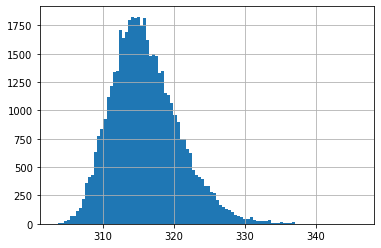

In [32]:
results_df["Fuel_L"].hist(bins=100)

In [32]:
import plotly.express as px
from plotly.subplots import make_subplots


results_df = SAs[512].results


def myround(x, base=5):
    return base * round(x / base)


px_fig = px.ecdf(
    results_df,
    x="Fuel_Gal",
    markers=True,
    lines=False,
    marginal="histogram",
)


fig = make_subplots(
    rows=2, cols=2, start_cell="top-left", shared_yaxes=True, vertical_spacing=0.2
)

for i, (p_name, name) in enumerate(
    [
        (
            "Fuel [L]",
            "Fuel_L",
        ),
        ("Average Travel Time [s]", "all_travel_time_average"),
        ("Average Delay [s]", "all_delay_average"),
        ("Ratio of Delay", "timeloss_ratio"),
    ]
):
    # px_fig = px.ecdf(
    #     results_df,
    #     x=name,
    #     markers=True,
    #     lines=False,
    #     marginal="histogram",
    #     # name="Simulation Data",
    # )
    # trace = px_fig.data[0]
    # trace.marker.color = "black"
    # trace.showlegend = i == 0
    # trace.name = "SA Sample"

    # fig.add_trace(trace, row=i // 2 + 1, col=i % 2 + 1)

    fig.add_trace(
        go.Scatter(
            x=[
                param_sweeps["SUMODefault"][name][0],
            ]
            * 2,
            y=(0, 1),
            line_color="rgba(208, 88, 126, 1)",
            showlegend=False,
            # fill="tonextx"
        ),
        row=i // 2 + 1,
        col=i % 2 + 1,
    )
    fig.add_trace(
        go.Scatter(
            x=[
                param_sweeps["SUMODefault"][name][1],
            ]
            * 2,
            y=(0, 1),
            fill="tonextx",
            line_color="rgba(208, 88, 126, 1)",
            name="Sumo Parameters",
            showlegend=i < 1,
        ),
        row=i // 2 + 1,
        col=i % 2 + 1,
    )

    fig.add_trace(
        go.Scatter(
            x=[
                param_sweeps["ShanghaiDefault"][name][0],
            ]
            * 2,
            y=(0, 1),
            line_color="rgba(229, 185, 173, 1)",
            showlegend=False,
            # fill="tonextx"
        ),
        row=i // 2 + 1,
        col=i % 2 + 1,
    )
    fig.add_trace(
        go.Scatter(
            x=[
                param_sweeps["ShanghaiDefault"][name][1],
            ]
            * 2,
            y=(0, 1),
            fill="tonextx",
            line_color="rgba(229, 185, 173, 1)",
            name="Paper 1 Parameters",
            showlegend=i < 1,
        ),
        row=i // 2 + 1,
        col=i % 2 + 1,
    )

    fig.add_trace(
        go.Scatter(
            x=[
                param_sweeps["CorrDefault"][name][0],
            ]
            * 2,
            y=(0, 1),
            line_color="rgba(0, 147, 146, 1)",
            showlegend=False,
            # fill="tonextx"
        ),
        row=i // 2 + 1,
        col=i % 2 + 1,
    )
    fig.add_trace(
        go.Scatter(
            x=[
                param_sweeps["CorrDefault"][name][1],
            ]
            * 2,
            y=(0, 1),
            fill="tonextx",
            line_color="rgba(0, 147, 146, 1)",
            name="Paper 2 Parameters",
            showlegend=i < 1,
        ),
        row=i // 2 + 1,
        col=i % 2 + 1,
    )
    # (315.43, 318.77)
    x, counts = np.unique(results_df[name], return_counts=True)
    y = np.cumsum(counts)
    _tmp_df = pd.DataFrame(data=[np.insert(x, 0, x[0]), np.insert(y/y[-1], 0, 0.)]).T

    _tmp_df.to_pickle(f"cars_{name}_cdf.pkl")
    
    fig.add_trace(
        go.Scatter(
            x=_tmp_df[0].values[::5],
            y=_tmp_df[1].values[::5],
            mode="markers",
            marker=dict(
                color="black",
                size=5,
            ),
            showlegend=i < 1,
            name="SA Sample",
        ),
        row=i // 2 + 1,
        col=i % 2 + 1,
    )

    _filtered_tmp_df = _tmp_df.loc[_tmp_df[0].isin(set(results_df.loc[results_df["cal_score"] < 1, name].values)), :]

    fig.add_trace(
        go.Scatter(
            x=_filtered_tmp_df[0],
            y=_filtered_tmp_df[1],
            mode="markers",
            marker=dict(
                color="crimson",
                size=12,
                symbol="x"
            ),
            showlegend=i < 1,
            name="Failed Calibration"
        ),
        row=i // 2 + 1,
        col=i % 2 + 1,
    )

    _b = 5 if results_df[name].max() > 5 else 0.1
    dtick = myround((results_df[name].max() - results_df[name].min()) / _b, _b)
    fig.update_layout(
        **{
            "xaxis"
            if i < 1
            else f"xaxis{i+1}": dict(
                title=p_name,
                nticks=10,
                showgrid=True,
                minor_showgrid=True,
                tickfont=dict(
                    size=16,
                ),
            ),
            "yaxis"
            if i < 1
            else f"yaxis{i+1}": dict(
                showgrid=True,
                minor_showgrid=True,
                ticks="outside" if i % 2 < 1 else "inside",
                title="Empirical cdf F(x)" if i % 2 < 1 else None,
                tickfont=dict(
                    size=16,
                ),
            ),
        }
    )  # range=_range, dtick=dtick,

fig.update_layout(
    template="simple_white",
    font_family="Open Sans",
    font_size=22,
    height=600,
    width=800,
    margin=dict(l=50, r=50, b=20, t=20, pad=4),
    legend=dict(yanchor="bottom", y=-0.38, xanchor="left", x=0, orientation="h"),
)


fig.update_annotations(font=dict(family="Open Sans", size=22))


fig.show()


### Create a List of the Most Sensitive Variables


In [32]:
si_df = SAs[512].si_df
results_df = SAs[1024].results.copy()

results_df = results_df.loc[results_df["Fuel_L"] < results_df["Fuel_L"].max()]

colorscale = [
    "rgba(0, 147, 146, 0)",
    "rgba(114, 170, 161, 0.2)",
    "rgba(177, 199, 179, 0.4)",
    "rgba(241, 234, 200, 0.6)",
    "rgba(229, 185, 173, 0.8)",
    "rgba(217, 137, 148, 1)",
    "rgba(208, 88, 126, 1)",
]

most_sensitive_variables = (
    si_df.sort_values(("all_delay_average", "ST"), ascending=False)
    .index.values[:4]
    .tolist()[::-1]
)

# results_df['log_Fuel_L'] = np.log(results_df['Fuel_L'])

fig = px.parallel_coordinates(
    results_df.reset_index(),
    color="all_delay_average",
    dimensions=most_sensitive_variables  # + ["cal_score_2", "Fuel_L", "all_delay_average", "timeloss_ratio", "all_travel_time_average"],
    + ["all_delay_average"],
    color_continuous_scale=colorscale,
)


for i, (dim, name) in enumerate(
    zip(fig.data[0]["dimensions"], most_sensitive_variables + ["all_delay_average"])
):
    try:
        label = NAME_2_LATEX[name]
        dim.label = ""
        # dim.label = NAME_2_LATEX[name]
    except KeyError:
        dim.label = ""
        label = "Average<br>Delay [s]"

    fig.add_annotation(
        text=label,
        xref="x domain",
        yref="y domain",
        x=0.25 * i,
        y=1.08 if label == "Average<br>Delay [s]" else 1.05,
        # showarrow=True,
        # If axref is exactly the same as xref, then the text's position is
        # absolute and specified in the same coordinates as xref.
        axref="x domain",
        # The same is the case for yref and ayref, but here the coordinates are data
        # coordinates
        ayref="y domain",
        ax=0,
        ay=0,
    )

    dim.range = [
        myround(results_df[name].min(), 0.01),
        myround(results_df[name].max(), 0.01),
    ]
    dim.tickvals = [str(v) for v in np.linspace(dim.range[0], dim.range[1], 6)]


fig.update_coloraxes(showscale=False)

fig.update_layout(
    template="simple_white",
    font_family="Open Sans",
    font_size=24,
    height=600,
    width=800,
    margin=dict(l=60, r=100, b=20, t=100, pad=4),
    # legend=dict(yanchor="bottom", y=1, xanchor="right", x=1, orientation="h")
)

fig.update_annotations(font=dict(family="Open Sans", size=24))
fig.write_html("delay.html", include_plotlyjs="cdn", include_mathjax="cdn")
# fig.write_image("fig_parallel_coordinates.png", width=800, height=600)

fig.show()


In [33]:
si_df = SAs[512].si_df
results_df = SAs[1024].results.copy()

results_df = results_df.loc[results_df["Fuel_L"] < results_df["Fuel_L"].max()]

colorscale = [
    "rgba(0, 147, 146, 0)",
    "rgba(114, 170, 161, 0.2)",
    "rgba(177, 199, 179, 0.4)",
    "rgba(241, 234, 200, 0.6)",
    "rgba(229, 185, 173, 0.8)",
    "rgba(217, 137, 148, 1)",
    "rgba(208, 88, 126, 1)",
]

most_sensitive_variables = (
    si_df.sort_values(("f_out", "ST"), ascending=False)
    .index.values[:4]
    .tolist()[::-1]
)

# results_df['log_Fuel_L'] = np.log(results_df['Fuel_L'])

fig = px.parallel_coordinates(
    results_df.reset_index(),
    color="Fuel_L",
    dimensions=most_sensitive_variables  # + ["cal_score_2", "Fuel_L", "all_delay_average", "timeloss_ratio", "all_travel_time_average"],
    + ["Fuel_L"],
    color_continuous_scale=colorscale,
)


for i, (dim, name) in enumerate(
    zip(fig.data[0]["dimensions"], most_sensitive_variables + ["Fuel_L"])
):
    try:
        label = NAME_2_LATEX[name]
        dim.label = ""
        # dim.label = NAME_2_LATEX[name]
    except KeyError:
        dim.label = ""
        label = "Fuel<br>Consumption [L]"

    fig.add_annotation(
        text=label,
        xref="x domain",
        yref="y domain",
        x=0.25 * i,
        y=1.08 if label == "Fuel<br>Consumption [L]" else 1.05,
        # showarrow=True,
        # If axref is exactly the same as xref, then the text's position is
        # absolute and specified in the same coordinates as xref.
        axref="x domain",
        # The same is the case for yref and ayref, but here the coordinates are data
        # coordinates
        ayref="y domain",
        ax=0,
        ay=0,
    )

    dim.range = [
        myround(results_df[name].min(), 0.01),
        myround(results_df[name].max(), 0.01),
    ]
    dim.tickvals = [str(v) for v in np.linspace(dim.range[0], dim.range[1], 6)]


fig.update_coloraxes(showscale=False)

fig.update_layout(
    template="simple_white",
    font_family="Open Sans",
    font_size=24,
    height=600,
    width=800,
    margin=dict(l=60, r=100, b=20, t=100, pad=4),
    # legend=dict(yanchor="bottom", y=1, xanchor="right", x=1, orientation="h")
)

fig.update_annotations(font=dict(family="Open Sans", size=24))
fig.write_html("Fuel.html", include_plotlyjs="cdn", include_mathjax="cdn")
# fig.write_image("fig_parallel_coordinates.png", scale=2, width=800, height=600)

fig.show()


In [34]:
import plotly.express as px

px.scatter(
    results_df.groupby("Tau").agg(
        {
            "all_delay_average": "median",
        }
    )
)


In [35]:
px.scatter(
    results_df.groupby("impatience").agg(
        {
            "all_delay_average": "median",
        }
    )
)


In [36]:
pd.qcut(results_df["Fuel_L"].values, q=100, labels=False)


array([17, 26, 14, ..., 20, 19, 22])

In [37]:
# px.scatter_matrix(
#     results_df[['speedFactor', 'Decel', 'Accel', 'minGap'] + ["f_out"]].sample(1000),
# )


colorscale = [
    "rgba(0, 147, 146, 1)",
    "rgba(114, 170, 161, 1)",
    "rgba(177, 199, 179, 1)",
    "rgba(241, 234, 200, 0)",
    "rgba(229, 185, 173, 1)",
    "rgba(217, 137, 148, 1)",
    "rgba(208, 88, 126, 1)",
]

fig = go.Figure(
    data=[
        go.Histogram2d(
            x=results_df["impatience"],
            y=results_df["Accel"],
            z=pd.qcut(results_df["all_delay_average"].values, q=100, labels=False),
            colorscale=colorscale,
            histfunc="avg",
        )
    ]
)

fig.update_layout(
    template="simple_white",
    font_family="Open Sans",
    font_size=24,
    height=800,
    width=800,
    margin=dict(l=60, r=80, b=20, t=80, pad=4),
    yaxis=dict(
        title="Accel [m/s²]",
    ),
    xaxis=dict(
        title="Impatience",
    ),
    # coloraxis=dict(colorbartitle="Fuel [L]",)
    # legend=dict(yanchor="bottom", y=1, xanchor="right", x=1, orientation="h")
)

fig.update_annotations(font=dict(family="Open Sans", size=24))

# results_df[SAs[512].problem['names'] + ["f_out"]].corr()


In [38]:
results_df["Fuel_L"]


0        311.632738
1        312.881545
2        311.273054
3        312.082527
4        312.247638
            ...    
47099    311.741994
47100    312.364129
47101    312.087955
47102    312.017025
47103    312.422045
Name: Fuel_L, Length: 47103, dtype: float64